# Preprocess US federal elections voting data

In [1]:
import pandas as pd
import geopandas as gpd
from tqdm import tqdm
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

c:\Users\b1066706\Anaconda3\envs\geo_env\lib\site-packages\geopandas\_compat.py:111: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(


## Functions

In [4]:
def get_votes_per_year(voting_data, year, threshold=0.5):

    """
    Retrieves voting data for a specified year and calculates various voting metrics.

    Parameters:
    - voting_data: DataFrame containing voting data.
    - year: Year for which voting data is to be retrieved.
    - threshold: Threshold value for classifying counties into voting clusters. Default is 0.5.

    Returns:
    - votes_per_year: DataFrame containing voting metrics for the specified year.
    """
    
    voting_data_year_filtered = voting_data[voting_data['year'] == year]
    DEMOCRAT_votes = []
    REPUBLICAN_votes = []
    OTHER_votes = []

    for cid in voting_data_year_filtered['county_fips'].dropna().unique():
        rows = voting_data_year_filtered[voting_data_year_filtered['county_fips'] == cid]

        dem_votes = np.sum(rows[rows['party'] == 'DEMOCRAT']['candidatevotes'].values)
        rep_votes = np.sum(rows[rows['party'] == 'REPUBLICAN']['candidatevotes'].values)
        other_votes = np.sum(rows[rows['party'] == 'OTHER']['candidatevotes'].values)

        # Handle cases where votes are 0
        if dem_votes == 0:
            dem_votes = rows[(rows['party'] == 'DEMOCRAT') & (rows['mode'] == 'TOTAL')]['candidatevotes'].values[0]
        if rep_votes == 0:
            rep_votes = rows[(rows['party'] == 'REPUBLICAN') & (rows['mode'] == 'TOTAL')]['candidatevotes'].values[0]
        if other_votes == 0:
            try:
                other_votes = rows[(rows['party'] == 'OTHER') & (rows['mode'] == 'TOTAL')]['candidatevotes'].values[0]
            except:
                other_votes = 0

        DEMOCRAT_votes.append(dem_votes)
        REPUBLICAN_votes.append(rep_votes)
        OTHER_votes.append(other_votes)

    votes_per_year = pd.DataFrame({
        'countyfips': [int(el) for el in voting_data_year_filtered['county_fips'].dropna().unique()],
        'dem_votes_'+str(year): DEMOCRAT_votes,
        'rep_votes_'+str(year): REPUBLICAN_votes,
        'other_votes_'+str(year): OTHER_votes
    })

    # Calculate total votes per county
    data = votes_per_year[['rep_votes_'+str(year), 'dem_votes_'+str(year), 'other_votes_'+str(year)]]
    votes_per_year['total_votes_'+str(year)] = data.sum(axis=1)

    # Calculate vote shares for each party
    votes_per_year['vote_share_rep_'+str(year)] = votes_per_year['rep_votes_'+str(year)] / votes_per_year['total_votes_'+str(year)]
    votes_per_year['vote_share_dem_'+str(year)] = votes_per_year['dem_votes_'+str(year)] / votes_per_year['total_votes_'+str(year)]
    votes_per_year['vote_share_other_'+str(year)] = votes_per_year['other_votes_'+str(year)] / votes_per_year['total_votes_'+str(year)]
    votes_per_year['voting_cluster_'+str(year)] = np.where(
    (votes_per_year['vote_share_rep_'+str(year)] > threshold),
    'Republicans',
    np.where(
        (votes_per_year['vote_share_dem_'+str(year)] > threshold),
        'Democrats',
        np.where(
            (votes_per_year['vote_share_other_'+str(year)] > threshold),
            'Other',
            'Swing_County'
        )
    )
)
    return votes_per_year

In [5]:
def consecutive_election_majority_df(votes_over_time, years):
    
    """
    Calculates the number of consecutive elections a county has voted for the same party majority.

    Parameters:
    - votes_over_time: DataFrame containing voting data over time.
    - years: List of years representing the election years.

    Returns:
    - DataFrame containing county FIPS codes, consecutive election counts, and the majority party.
    """

    result = {'countyfips': [], 'consecutiveElections': [], 'maxConsecutiveParty': []}

    for county in votes_over_time['countyfips']:
        consecutive_elections = 1 # Start with zero here to account for special edge cases! Explained in the Paper! Decision rule: if maxx_consecutive_elections > years/2 : then max_party cluster; else Swing_County
        maxx_consecutive_elections = 1
        max_party = None

        for i in range(len(years) - 1):
            year1, year2 = years[i], years[i + 1]

            party1 = votes_over_time[f'voting_cluster_{year1}'][votes_over_time['countyfips'] == county].values[0]
            party2 = votes_over_time[f'voting_cluster_{year2}'][votes_over_time['countyfips'] == county].values[0]

            if party1 == party2:
                consecutive_elections += 1
                if consecutive_elections > maxx_consecutive_elections:
                    maxx_consecutive_elections = consecutive_elections
                    max_party = party1
            else:
                consecutive_elections = 1

        result['countyfips'].append(county)
        result['consecutiveElections'].append(maxx_consecutive_elections)
        result['maxConsecutiveParty'].append(max_party)

    return pd.DataFrame(result)


In [6]:
def count_consecutive_party_wins(consecutive_df, num_consecutive_elections):
    """
    Counts the number of consecutive party wins for Democrats and Republicans.

    Parameters:
    - consecutive_df: DataFrame containing information about consecutive elections.
    - num_consecutive_elections: Number of consecutive elections to analyze.

    Returns:
    - DataFrame with counts of consecutive party wins for Democrats and Republicans.
    """
    result = {'Consecutive elections': range(1, num_consecutive_elections + 1),
              'Democrats': [],
              'Republicans': []}

    for i in range(1, num_consecutive_elections + 1):
        # Filter rows with the specified number of consecutive elections
        filtered_df = consecutive_df[consecutive_df['consecutiveElections'] == i]

        # Count Democrats and Republicans for the current number of consecutive elections
        dem_count = (filtered_df['maxConsecutiveParty'] == 'Democrats').sum()
        rep_count = (filtered_df['maxConsecutiveParty'] == 'Republicans').sum()

        result['Democrats'].append(dem_count)
        result['Republicans'].append(rep_count)

    return pd.DataFrame(result)

In [7]:
def categorize_counties_by_consecutive_wins(consecutive_df, years):
    """
    Categorizes counties based on their consecutive election wins.

    Parameters:
    - consecutive_df: DataFrame containing information about consecutive election wins for counties.
    - years: List of years corresponding to the consecutive election data.

    Returns:
    - DataFrame with counties categorized based on their consecutive election wins.
    """
    result = {'countyfips': [],
              'category': []}

    for index, row in consecutive_df.iterrows():
        countyfips = row['countyfips']
        max_consecutive_elections = row['consecutiveElections']

        if max_consecutive_elections > len(years) / 2 + 1:# > len(years) / 2 + 1:
            category = row['maxConsecutiveParty']  # Assumes maxConsecutiveParty is either 'Republicans' or 'Democrats'
        else:
            category = 'Swing_County'

        result['countyfips'].append(countyfips)
        result['category'].append(category)

    return pd.DataFrame(result)


# Load the voting data

In [8]:
county_data = gpd.read_file("../../../data/utils/county_data.shp", index_col = 0)

In [9]:
# Source: Voting data: 
# https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/VOQCHQ
voting_data = pd.read_csv('../../../data/voting_data/voting_data.csv')

# Swing County Definition based on historic election outcomes (last six elections)

## Add voting data for each year to the counties

In [10]:
# Initialize merged_dataframe if it doesn't exist
votes_over_time = None
years = [ 2000, 2004, 2008, 2012, 2016, 2020]

# Loop through years and add votes to the merged_dataframe
for year in years:
    votes_per_year = get_votes_per_year(voting_data, year)
    if votes_over_time is None:
        votes_over_time = votes_per_year
    else:
        votes_over_time = pd.merge(votes_over_time, votes_per_year, on='countyfips', how='left')
    

## Get the consecutive Election winners

In [11]:
# get the max amount of consecutive wins for a party over the last 6 elections
years_to_check = years
consecutive_df = consecutive_election_majority_df(votes_over_time, years_to_check)
consecutive_df.columns


Index(['countyfips', 'consecutiveElections', 'maxConsecutiveParty'], dtype='object')

In [13]:
consecutive_df

,countyfips,consecutiveElections,maxConsecutiveParty
0,1001,6,Republicans
1,1003,6,Republicans
2,1005,2,Republicans
3,1007,6,Republicans
4,1009,6,Republicans
...,...,...,...
3149,2037,3,Republicans
3150,2038,4,Democrats
3151,2039,4,Democrats
3152,2040,3,Republicans


In [12]:
num_consecutive_elections = 6
result_df = count_consecutive_party_wins(consecutive_df, num_consecutive_elections)

# Display the result DataFrame
result_df


,Consecutive elections,Democrats,Republicans
0,1,0,0
1,2,50,155
2,3,47,214
3,4,172,69
4,5,33,102
5,6,299,1984


## Categorize each County into Republicans, Democrats, Swing_County

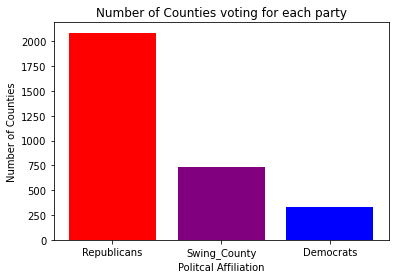

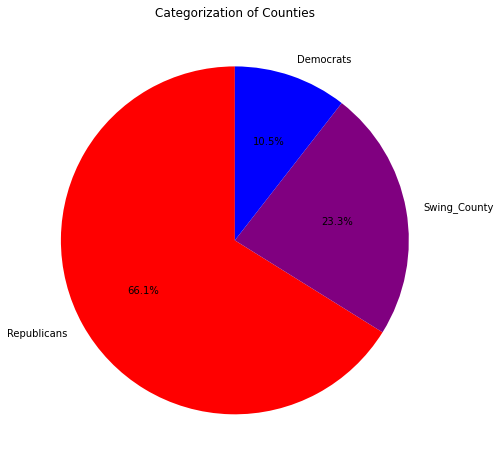

In [14]:
categorized_counties = categorize_counties_by_consecutive_wins(consecutive_df, years)

# Plot Bar Chart
category_counts = categorized_counties['category'].value_counts()
colors = {'Republicans': 'red', 'Democrats': 'blue', 'Swing_County': 'purple'}
plt.bar(category_counts.index, category_counts.values, color=[colors[category] for category in category_counts.index])
plt.xlabel('Politcal Affiliation')
plt.ylabel('Number of Counties')
plt.title('Number of Counties voting for each party')
plt.show()

# Plot Pie Chart
fig, ax = plt.subplots(figsize=(8, 8))
ax.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', colors=[colors[category] for category in category_counts.index], startangle=90)
plt.title('Categorization of Counties')
plt.show()

## Merge county geometries with county categories

In [15]:
# Merge the DataFrames on 'countyfips'
merged_data = pd.merge(county_data, categorized_counties, on='countyfips',  how='left')

# Convert the DataFrame to GeoDataFrame
geo_df = gpd.GeoDataFrame(merged_data, geometry='geometry')


In [16]:
geo_df = geo_df[['id', 'name', 'geoid', 'countyfips', 'state', 'population',
       'state_full', 'geometry', 'category']]
geo_df.columns = ['id', 'name', 'geoid', 'countyfips', 'state', 'population',
       'state_full', 'geometry', 'Clusters']
geo_df[['name', 'countyfips', 'state', 'population','state_full', 'Clusters']].to_csv("../../../data/voting_data/votes_per_county.csv")

c:\Users\b1066706\Anaconda3\envs\geo_env\lib\site-packages\geopandas\io\file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


In [24]:
geo_df.dropna().to_file("../../../data/voting_data/county_political_clusters_6elections.shp", index_col = 0)
geo_df[['name', 'countyfips', 'state', 'population','state_full', 'Clusters']].to_csv("../../../data/voting_data/votes_per_county_6elections.csv")

c:\Users\b1066706\Anaconda3\envs\geo_env\lib\site-packages\geopandas\io\file.py:362: FutureWarning:

pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.



## Add population weighting

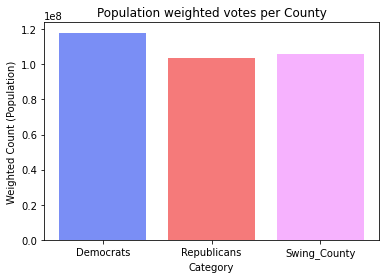

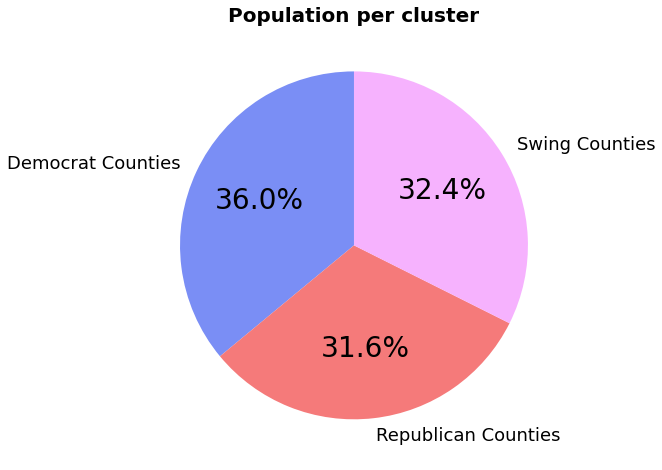

In [31]:
# Weighted counts
weighted_counts = geo_df.groupby('Clusters')['population'].sum()

# Plot Weighted Bar Chart
colors = {'Republicans': '#F57A7A', 'Democrats': '#7A8EF5', 'Swing_County': '#F6B2FE', 'No_Data': 'grey'}
plt.bar(weighted_counts.index, weighted_counts.values, color=[colors[category] for category in weighted_counts.index])
plt.xlabel('Category')
plt.ylabel('Weighted Count (Population)')
plt.title('Population weighted votes per County')
plt.show()

# Plot Weighted Pie Chart
fig, ax = plt.subplots(figsize=(8, 8))
wedges, texts, autotexts = ax.pie(weighted_counts, labels=[ 'Democrat Counties', 'Republican Counties','Swing Counties'], autopct='%1.1f%%', 
                                  colors=[colors[category] for category in weighted_counts.index], startangle=90,
                                   textprops={'color': 'Black', 'fontsize': 18})

plt.setp(autotexts, size=28)  # Set size and weight of percentage labels

plt.title('Population per cluster', size=20, weight="bold")
plt.show()

In [19]:
import plotly.express as px
geo_df = geo_df.fillna('No_Data')
# Assuming you want to display counties with certain conditions
filtered_geo_df = geo_df.copy()
category_color_map = {
    'Republicans': 'red',
    'Democrats': 'darkblue',
    'Swing_County': 'purple',
    'No_Data': 'grey'
    # Add more categories and colors as needed
}

# Create the choropleth map
fig = px.choropleth(filtered_geo_df, geojson=filtered_geo_df.geometry, locations=filtered_geo_df.index,
                    color='Clusters',
                    color_discrete_map=category_color_map,  
                    scope="usa",
                    labels={'Clusters': 'Political Cluster'}
                   )

# Adjust layout
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})

# Show the map
fig.show()
